In [29]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Assignment 4

## Image Segmentation using K-means

Implement K-means algorithm using only the numpy library. You can use opencv and matplotlib libraries only to read and display images. Apply K-means to the images 'home' and 'flower' shown in Figure 1. Try K=2 and K=3. Run the algorithm for 10 iterations and display the resulting segmented images in each case.

In [2]:
def display_single_image(img, name):
    """Display a single image nicely."""
    plt.figure(figsize=(20, 20))
    plt.subplot(111), plt.imshow(img, cmap="gray_r")
    plt.title(name), plt.xticks([]), plt.yticks([])
    plt.show()

In [3]:
def convert_to_grey(img):
    """Returns the greyscale conversion of an image."""
    return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

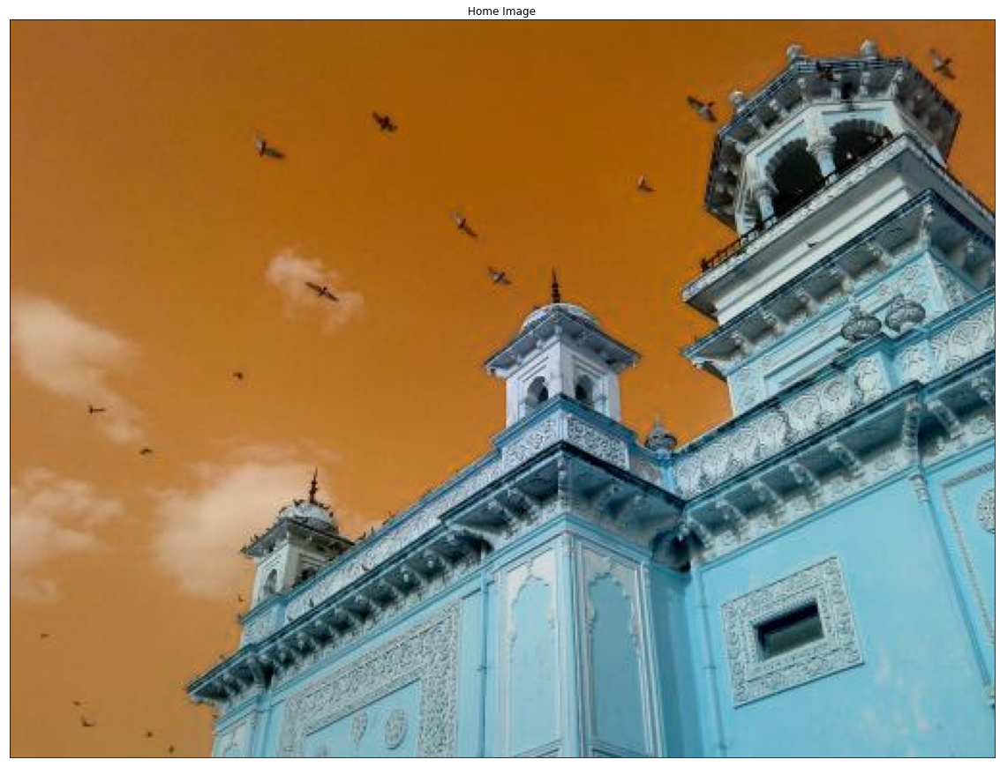

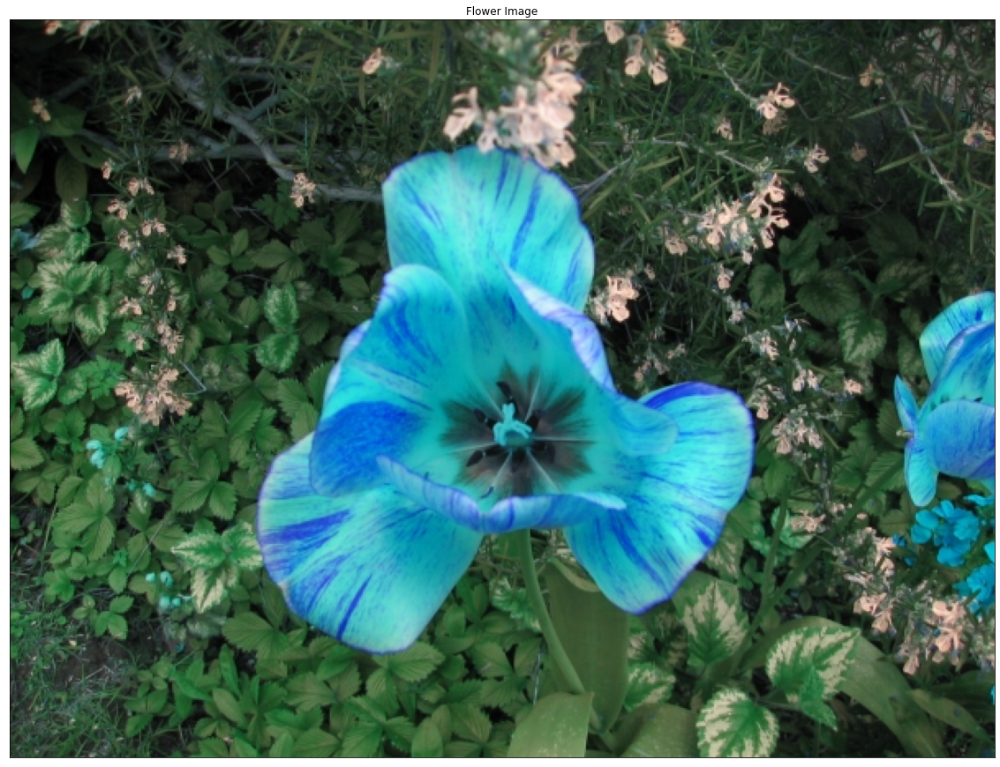

In [4]:
# load in reference images
home_img = cv2.imread("home.jpg")
flower_img = cv2.imread("flower.jpg")
display_single_image(home_img, "Home Image")
display_single_image(flower_img, "Flower Image")

In [5]:
def kmeans(img, k, num_iterations):
  cluster_centers = []
    
  # generate random cluster centers
  for i in range(k):
    cluster_centers.append(np.random.randint(0, 256, 3))
  cluster_centers = np.array(cluster_centers)

  for i in range(num_iterations):
    # find the euclidean distance between each pixel and the cluster centers, take index of smallest
    if k == 2:
      labels = np.array([np.argmin([np.linalg.norm(j - cluster_centers[0]),np.linalg.norm(j - cluster_centers[1])], axis=0) for j in img])
    elif k == 3:
      labels = np.array([np.argmin([np.linalg.norm(j - cluster_centers[0]),np.linalg.norm(j - cluster_centers[1]), np.linalg.norm(j - cluster_centers[2])], axis=0) for j in img])
    
    cluster_centers = []

    for n in range(k):
      f = img[labels == n]
      cluster_centers.append(np.mean(f, axis=0))

    cluster_centers = np.array(cluster_centers)

  return labels, cluster_centers

In [6]:
# perform k-means for k=2
home_height, home_width = home_img.shape[:2]
home_labels_2, home_centers_2 = kmeans(home_img.reshape((-1, 3)), 2, 10)
home_labels_3, home_centers_3 = kmeans(home_img.reshape((-1, 3)), 3, 10)

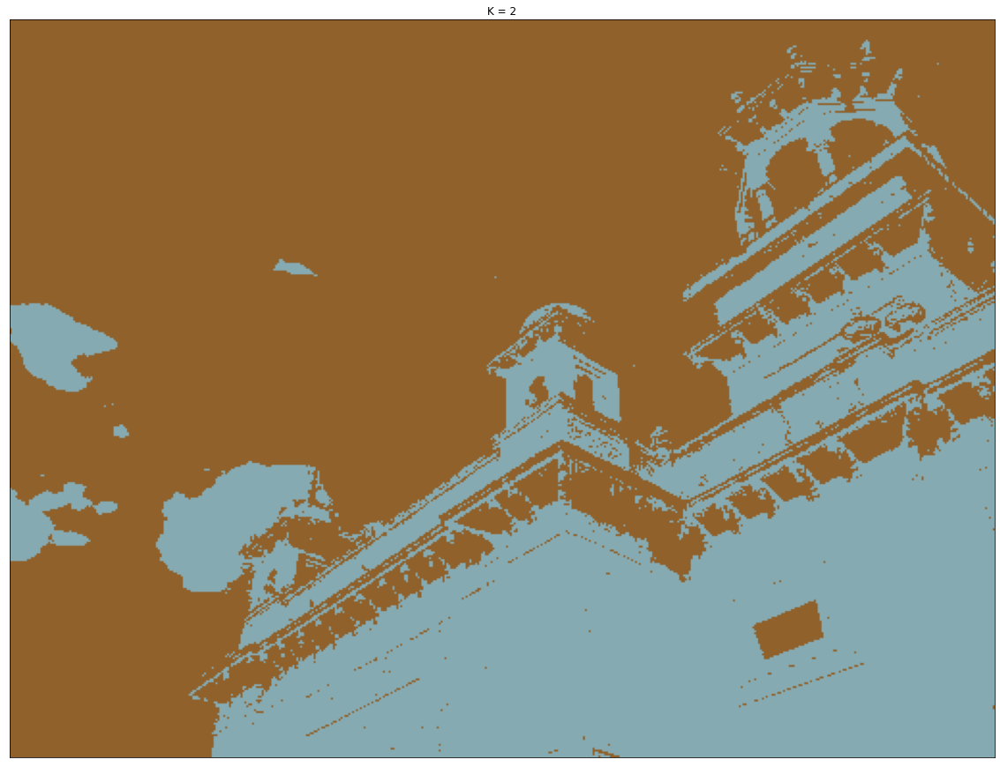

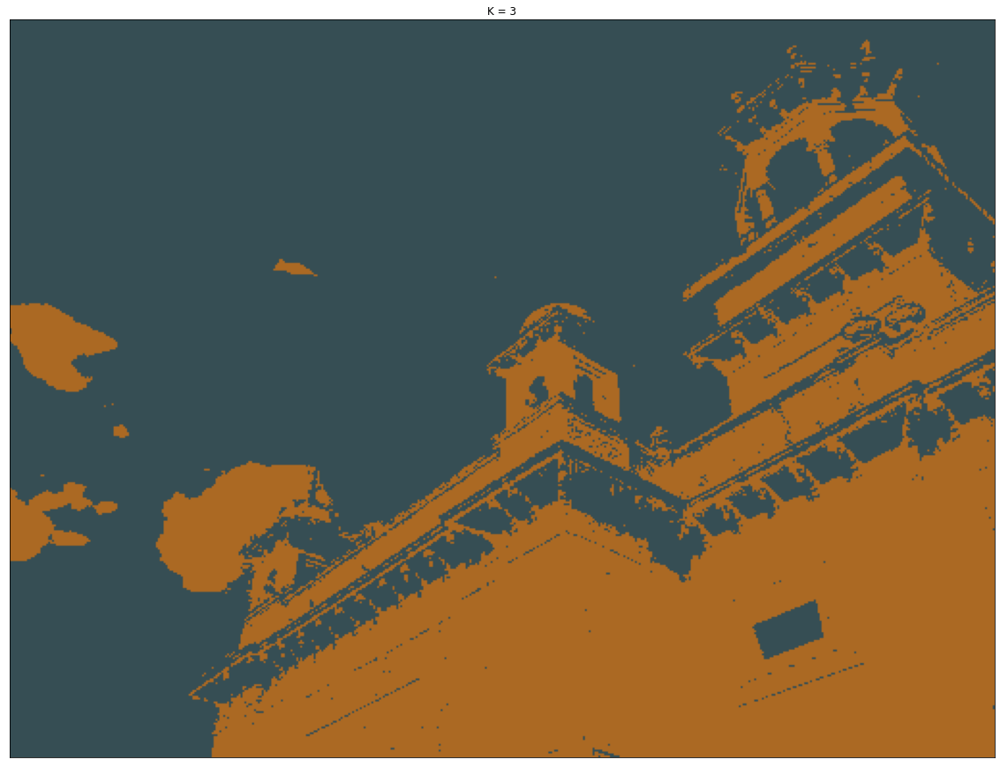

In [7]:
# display segmented home images
home_disp_2 = np.asarray([home_centers_2[label] for label in home_labels_2])
home_disp_3 = np.asarray([home_centers_3[label] for label in home_labels_2])

home_segmented_2 = np.reshape(home_disp_2, (home_height, home_width, 3)).astype("uint8")
home_segmented_3 = np.reshape(home_disp_3, (home_height, home_width, 3)).astype("uint8")

display_single_image(home_segmented_2, "K = 2")
display_single_image(home_segmented_3, "K = 3")

In [8]:
# perform k-means for k=2
flower_height, flower_width = flower_img.shape[:2]
flower_labels_2, flower_centers_2 = kmeans(flower_img.reshape((-1, 3)), 2, 10)
flower_labels_3, flower_centers_3 = kmeans(flower_img.reshape((-1, 3)), 3, 10)

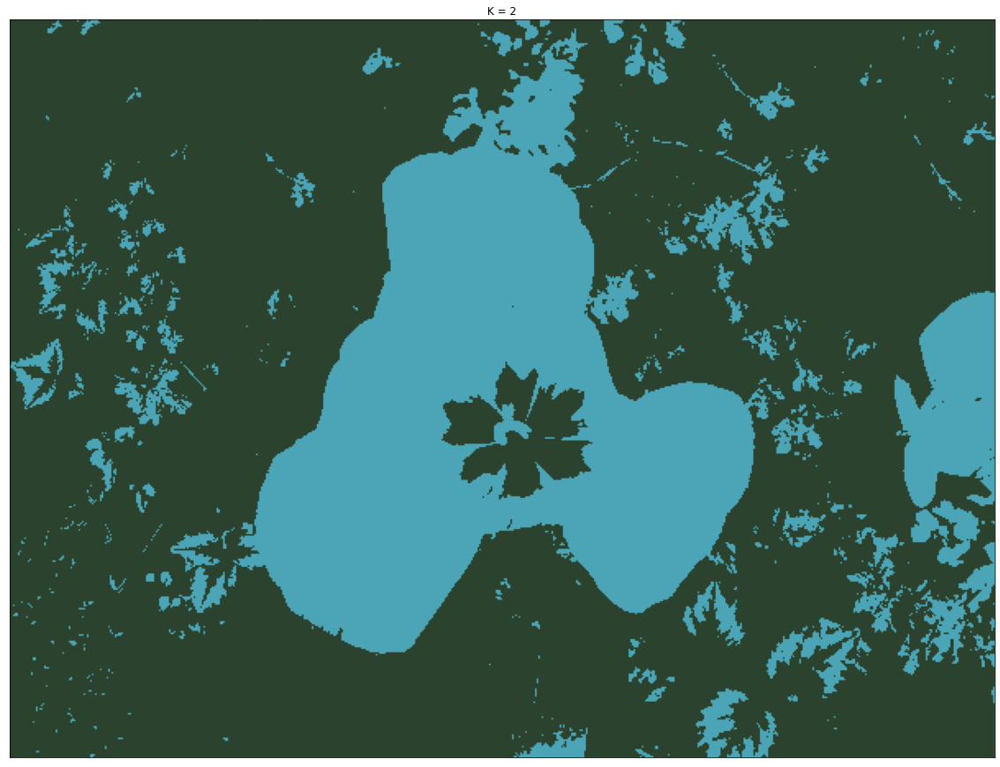

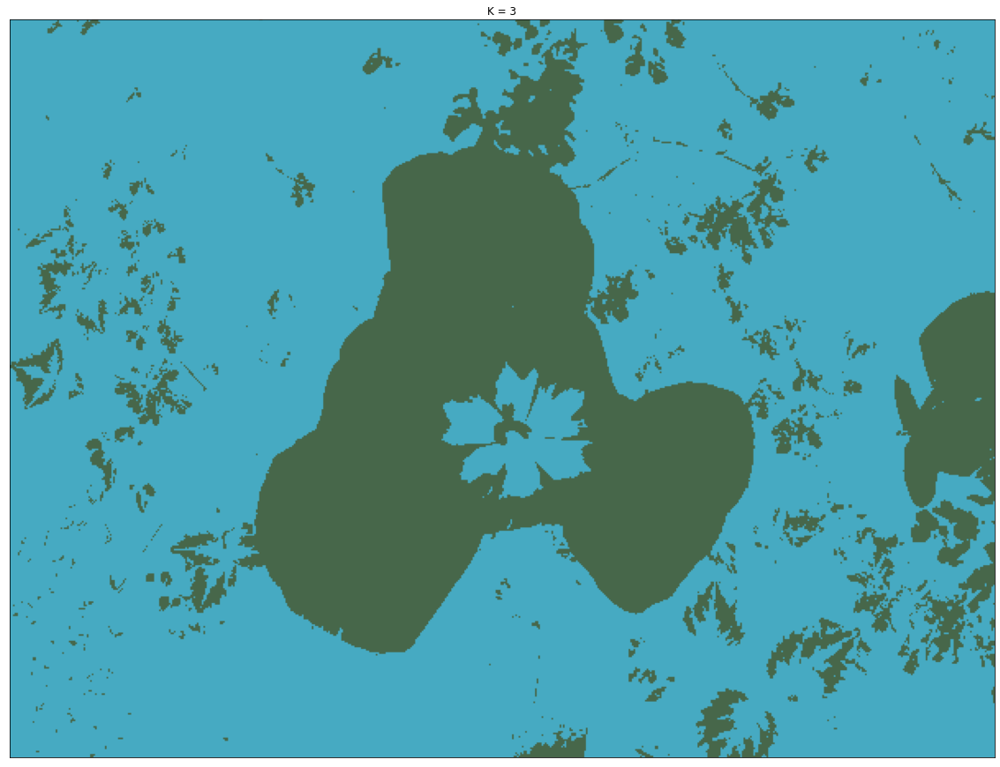

In [9]:
# display segmented flower images
flower_disp_2 = np.asarray([flower_centers_2[label] for label in flower_labels_2])
flower_disp_3 = np.asarray([flower_centers_3[label] for label in flower_labels_2])

flower_segmented_2 = np.reshape(flower_disp_2, (flower_height, flower_width, 3)).astype("uint8")
flower_segmented_3 = np.reshape(flower_disp_3, (flower_height, flower_width, 3)).astype("uint8")

display_single_image(flower_segmented_2, "K = 2")
display_single_image(flower_segmented_3, "K = 3")

## Disparity

1. Extract a 5 × 5 window centered at each pixel-location (i, j)L in the left image. Let’s call these windows reference windows.
2. For each reference window in the left image do the following:
   1. On the right scanline, create a search region bounded by pixel-locations (i, j−47)R and (i, j)R. Extract 5×5 windows centered at every pixellocation in this search region.
   2. For few boarder pixel-locations either the reference window or the search region lie outside the boundary of the image. Set disparity D(i, j) = 48 for these pixel-locations. For the remaining locations do the following.
   3. Compute sum-of-square-difference(SSD) between the windows in the search region and the reference window.
   4. Find a location (i', j')R with minimum SSD and compute disparity D(i, j) = jL − j'R. (Note that 0 ≤ D(i, j) ≤ 47 as the search region contains 48 pixel-locations.)
3. Display the final disparity map D with the cmap argument of plt.imshow set to ‘gray r’. The expected output is shown in Figure 2(c).

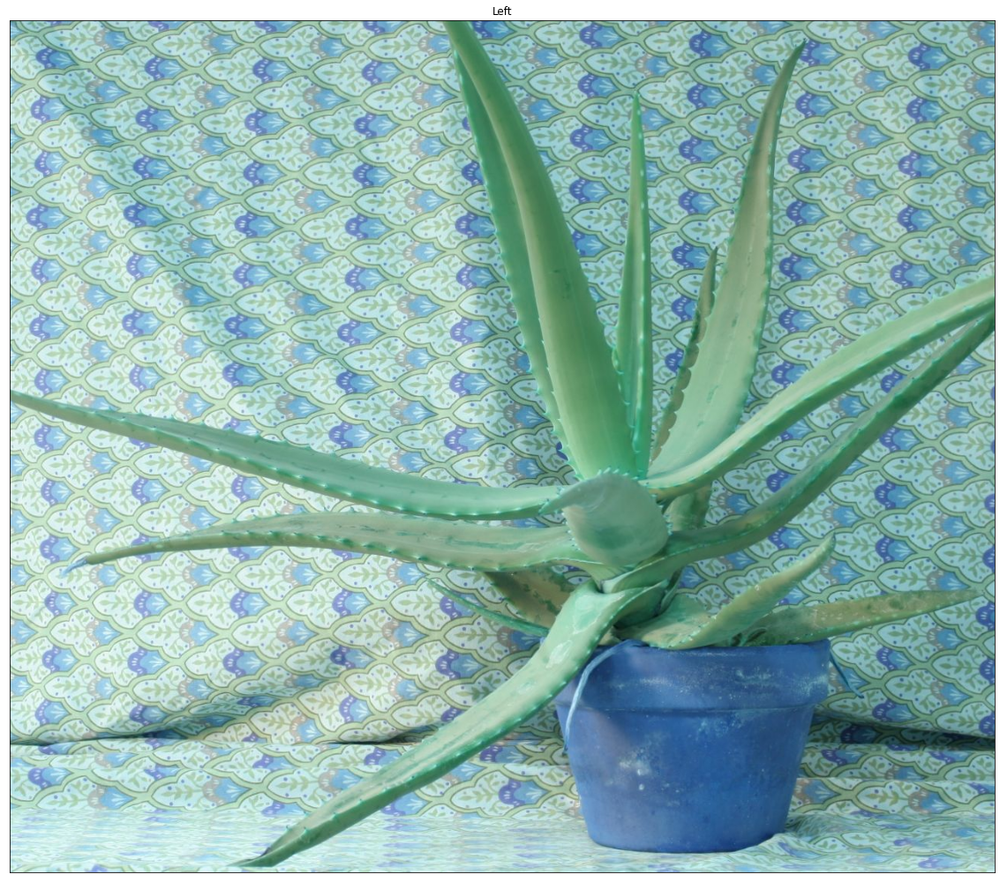

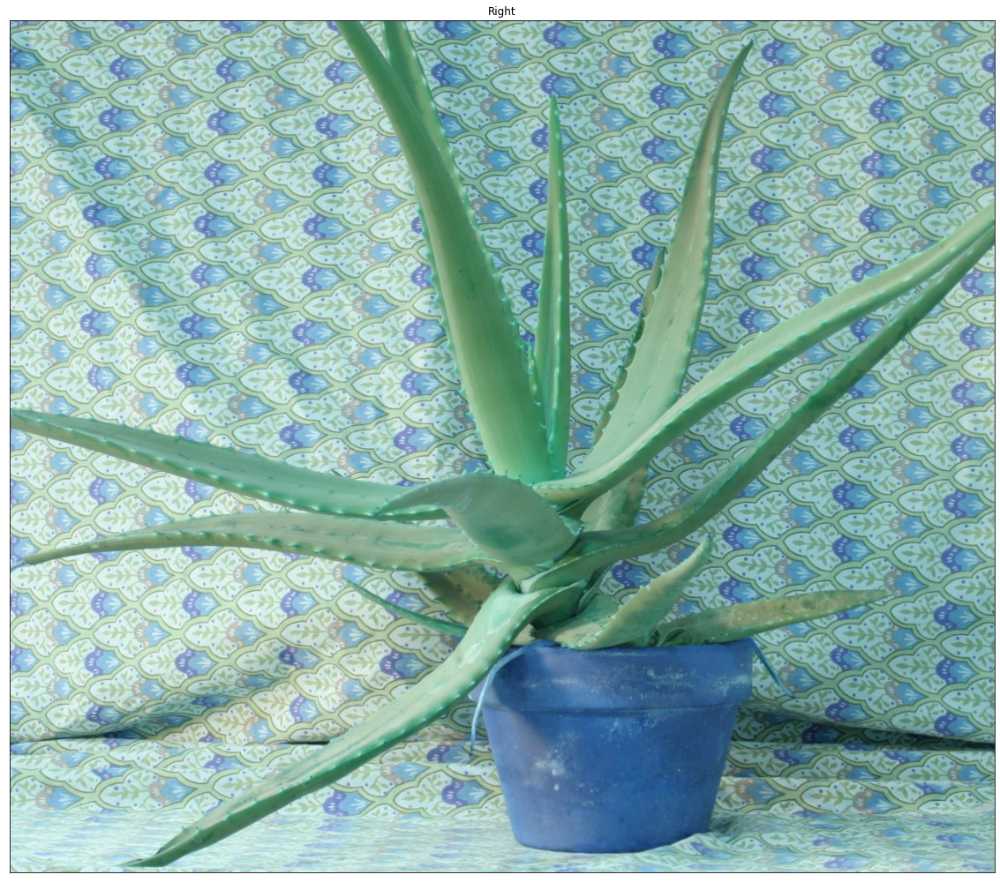

In [10]:
# load in L and R images
left_img = cv2.imread("aloeL.jpg")
right_img = cv2.imread("aloeR.jpg")
display_single_image(left_img, "Left")
display_single_image(right_img, "Right")

In [11]:
# convert to greyscale
left_grey = convert_to_grey(left_img)
right_grey = convert_to_grey(right_img)

In [12]:
# resize images for fast processing
left_small = cv2.resize(left_grey, None, fx=0.3, fy=0.3)
right_small = cv2.resize(right_grey, None, fx=0.3, fy=0.3)

In [13]:
# declare sum of squared differences function
SSD = lambda search_window, reference_window: np.sum(np.square(search_window - reference_window))

In [14]:
# initialize disparity image
LR_height, LR_width = left_small.shape
LR_disparity = np.zeros((LR_height, LR_width), dtype=np.uint8)

# create 5x5 window at every pixel in left image
for i in range(LR_height):
    for j in range(LR_width):
        # if on border of reference (left) image, set disparity to 48
        if i < 2 or i >= LR_height - 2 or j < 47 or j >= LR_width - 2:
            LR_disparity[i,j] = 48
        else:
            # local variables to store the SSD-minimizing index along scanline
            min_SSD = None
            min_k = None

            # check scanline, calculate SSD of each window compared to reference window
            # select the scanline index whose SSD is smallest
            for k in range(j - 47, j):
                if k < 2:
                    pass
                else:
                    temp_SSD = SSD(right_small[i-2:i+2,k-2:k+2],left_small[i-2:i+2,j-2:j+2])
                    if min_SSD == None:
                        min_SSD = temp_SSD
                        min_k = k
                    elif temp_SSD < min_SSD:
                        min_SSD = temp_SSD
                        min_k = k
            # if a minimum was found, calculate disparity
            if min_k != None:
                # per a thread in the discussion board, to make the disparate spaces dark, non-disparate light
                LR_disparity[i,j] = 47 - (j - min_k)
            else:
                LR_disparity[i,j] = 48
            

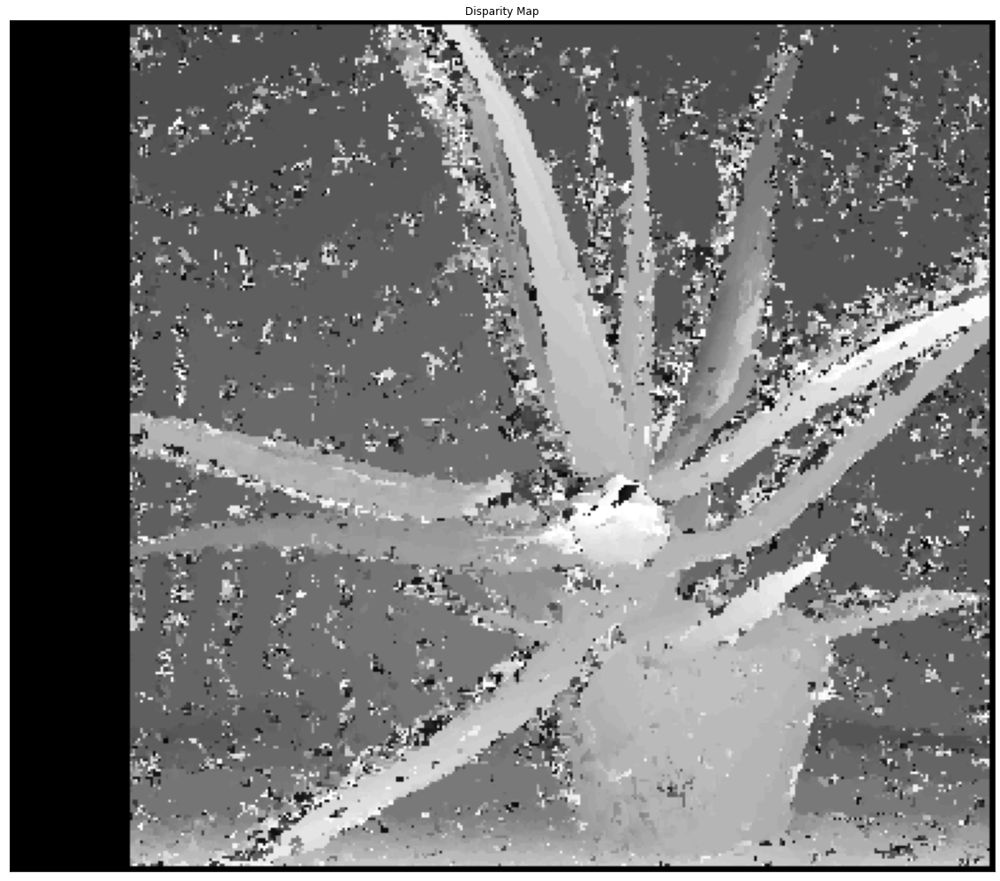

In [15]:
# display disparity map
display_single_image(LR_disparity, "Disparity Map")

## Optical Flow

1. Use `calcOpticalFlowFarneback` from OpenCV to compute optical flow between the input frames with the arguments set as follows.
   1. flow=None, pyr scale=0.5, levels=3, iterations=3, poly n=5, poly sigma=1.2 and flags=0.
   2. Vary winsize from 5 to 21 in the steps of 2.
2. For each setting of winsize, measure mean squared error(MSE) between estimated optical flow and the ground truth optical flow. Plot MSE (yaxis) vs winsize (x-axis).
3. Do you observe any trend in the plot above? Does the error increase or decrease with increasing window-size? Explain the effect of window-size on the prediction error.

In [16]:
# load in the dataset
flow10_dataset = np.load("flow10.npz")
ground_truth = flow10_dataset['flow']

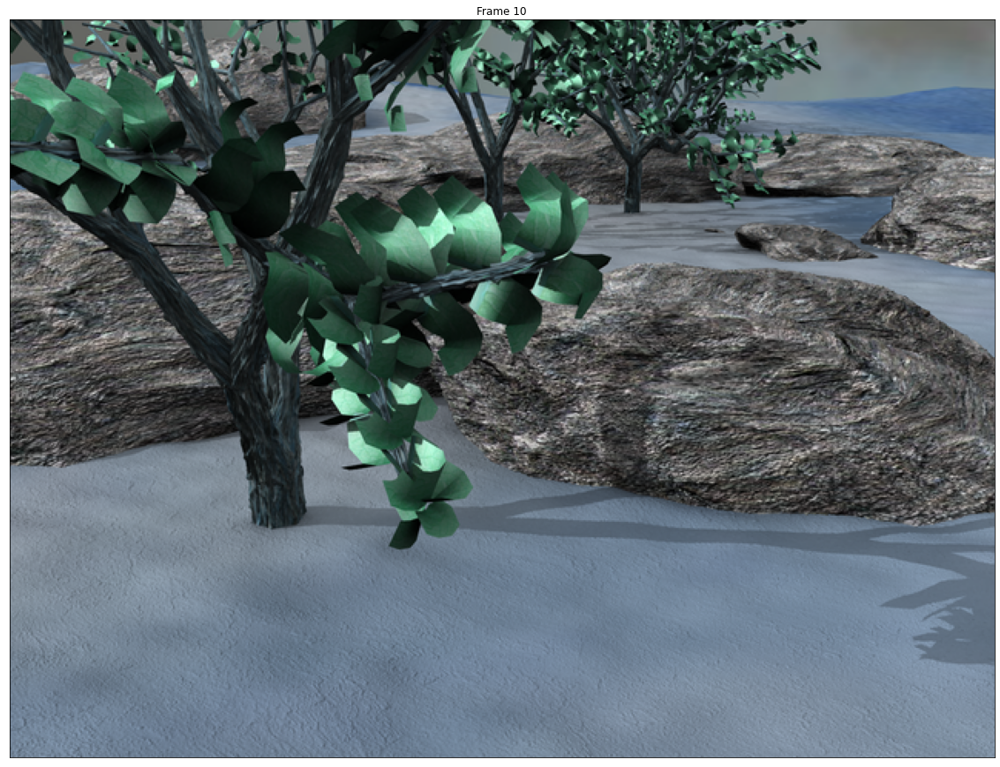

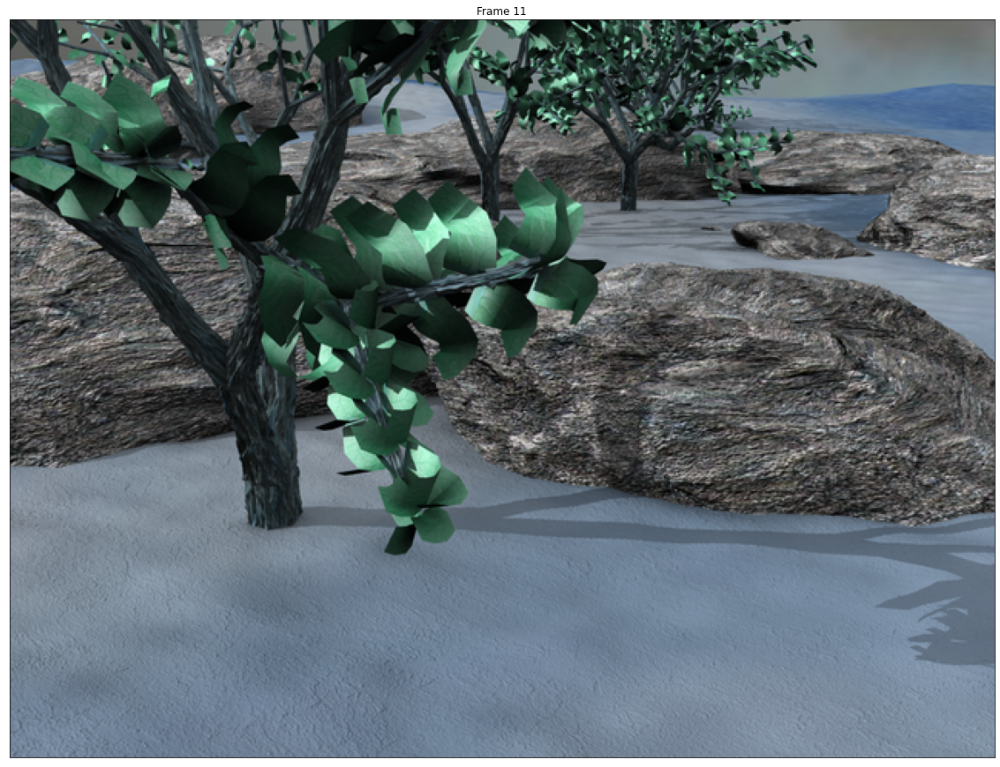

In [19]:
# load in reference images
frame10_img = cv2.imread("frame10.png")
frame11_img = cv2.imread("frame11.png")
display_single_image(frame10_img, "Frame 10")
display_single_image(frame11_img, "Frame 11")

In [21]:
#convert to greyscale
frame10_grey = convert_to_grey(frame10_img)
frame11_grey = convert_to_grey(frame11_img)

In [24]:
# calculate flows and mean squared errors
flows = []
MSEs = []
winsizes = range(5, 22, 2)
for size in winsizes:
    flow = cv2.calcOpticalFlowFarneback(prev=frame10_grey, next=frame11_grey, flow=None, pyr_scale=0.5, levels=3, winsize=size, iterations=3, poly_n=5, poly_sigma=1.2, flags=0)
    mse = (np.square(flow - ground_truth)).mean()
    flows.append(flow)
    MSEs.append(mse)

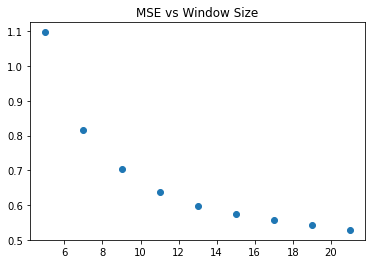

In [28]:
# plot MSE vs window size
plt.figure()
plt.scatter(winsizes, MSEs)
plt.title("MSE vs Window Size")
plt.show()

We observe above that the MSE decreases with increasing window size, and that the nature of the relation seems to be exponential decay. With a bigger window size, the Farneback algorithm has more information to construct an accurate polynomial with which to approximate the window. More accurate model of the windows => more accurate measure of optical flow.